<a href="https://colab.research.google.com/github/bhgtankita/MYWORK/blob/master/Assignment4_TintImageNet_AnkitaBhagat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TinyImageNet - Dataset
Training images - 100000;
Validation images - 10000;
Nuber of classes - 200;
image size - 64x64

# Summary : Achieved 53.52 % Validation accuracy in 38 epochs using 1,320,416 parameters

Training loss: 1.5055 - Training acc: 0.7081 - Validation loss: 2.3031 - Validation acc: 0.5352

Started training with 16x16 images and then resize images to 32x32 and finally 64x64. After training for 21 epochs achieved 47.23 % Validation accuracy. 

Then I seperated misclassified images in training dataset to apply augmentation. After applying 7 different augmentations from *IMGAUG* on 37881 misclassified training images, generated 303048 images. Also added correctly classified images to it do network will not forget what it already learnt. Again resumed the training on 64x64 image size and after total 38 epochs got 53.52% accuracy.








In [0]:
!kill -9 -1

In [0]:
!ls

sample_data


# Mounting google drive

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

# Download and Unzip data

In [0]:
!wget http://cs231n.stanford.edu/tiny-imagenet-200.zip
!unzip -q tiny-imagenet-200.zip  #quiter

--2019-04-09 17:21:10--  http://cs231n.stanford.edu/tiny-imagenet-200.zip
Resolving cs231n.stanford.edu (cs231n.stanford.edu)... 171.64.68.10
Connecting to cs231n.stanford.edu (cs231n.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248100043 (237M) [application/zip]
Saving to: ‘tiny-imagenet-200.zip’

tiny-imagenet-200.z 100%[===================>] 236.61M  20.4MB/s    in 15s     

2019-04-09 17:21:25 (16.3 MB/s) - ‘tiny-imagenet-200.zip’ saved [248100043/248100043]



# Initialization

In [0]:
from keras.utils import np_utils
import os
import numpy as np
from PIL import Image
from keras import callbacks
from keras import optimizers
from keras.callbacks import ReduceLROnPlateau, CSVLogger, EarlyStopping, ModelCheckpoint
from keras.models import Model
from keras.layers import Activation, Convolution2D, Dropout, GlobalAveragePooling2D, Concatenate, Dense, Input, AveragePooling2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
from keras.regularizers import l2
from keras.models import load_model
from keras.optimizers import Adam
import pandas as pd

Using TensorFlow backend.


In [0]:
__version__ = '0.0.2'

img_channels=3
img_rows=16
img_cols=16
nb_classes=200
batch_size=100
nb_epoch = 10
data_augmentation = False

# Data Preprocessing

In [0]:
def get_annotations_map():
	valAnnotationsPath = './tiny-imagenet-200/val/val_annotations.txt'
	valAnnotationsFile = open(valAnnotationsPath, 'r')
	valAnnotationsContents = valAnnotationsFile.read()
	valAnnotations = {}

	for line in valAnnotationsContents.splitlines():
		pieces = line.strip().split()
		valAnnotations[pieces[0]] = pieces[1]
    
	return valAnnotations

In [0]:
def load_images(path,num_classes,img_size):
    #Load images
    
    print('Loading ' + str(num_classes) + ' classes')

    X_train=np.zeros([num_classes*500,3,img_size,img_size],dtype='uint8')
    X_train_filenames = np.empty(num_classes*500, dtype=object)
    y_train=np.zeros([num_classes*500], dtype='uint8')

    trainPath=path+'/train'

    print('loading training images...');

    i=0
    j=0
    annotations={}
    for sChild in os.listdir(trainPath):
        sChildPath = os.path.join(os.path.join(trainPath,sChild),'images')
        annotations[sChild]=j
        for c in os.listdir(sChildPath):
            #X=np.array(Image.open(os.path.join(sChildPath,c)))
            im = Image.open(os.path.join(sChildPath,c))
            X_train_filenames[i] = im.filename
            X=np.array(im.resize((img_size,img_size)))
            if len(np.shape(X))==2:
                X_train[i]=np.array([X,X,X])
            else:
                X_train[i]=np.transpose(X,(2,0,1))
            y_train[i]=j
            i+=1
        j+=1
        if (j >= num_classes):
            break

    print('finished loading training images')

    val_annotations_map = get_annotations_map()

    X_test = np.zeros([num_classes*50,3,img_size,img_size],dtype='uint8')
    y_test = np.zeros([num_classes*50], dtype='uint8')


    print('loading test images...')

    i = 0
    testPath=path+'/val/images'
    for sChild in os.listdir(testPath):
        if val_annotations_map[sChild] in annotations.keys():
            sChildPath = os.path.join(testPath, sChild)
            im=Image.open(sChildPath)
            X=np.array(im.resize((img_size,img_size)))
            #X=np.array(Image.open(sChildPath))
            if len(np.shape(X))==2:
                X_test[i]=np.array([X,X,X])
            else:
                X_test[i]=np.transpose(X,(2,0,1))
            y_test[i]=annotations[val_annotations_map[sChild]]
            i+=1
        else:
            pass


    print("finished loading test images"+str(i))
    
    X_train = np.moveaxis(X_train, 1,-1)
    X_test = np.moveaxis(X_test, 1,-1)
    y_train = np_utils.to_categorical(y_train, nb_classes)
    y_test = np_utils.to_categorical(y_test, nb_classes)
    
    return X_train,y_train,X_test,y_test,X_train_filenames

In [0]:
def data_normalization(X_train, X_test):
  X_train = X_train.astype('float32')
  X_test = X_test.astype('float32')

  # subtract mean and normalize
  mean_image = np.mean(X_train, axis=0)
  X_train -= mean_image
  X_test -= mean_image
  X_train /= 255.
  X_test /= 255.
  
  return X_train, X_test

# DenseNet Architecture

3 Dense Blocks each with 4 layers


In [0]:
def DenseNet(
    input_shape=None,
    dense_blocks=3,
    dense_layers=4,
    growth_rate=12,
    nb_classes=None,
    dropout_rate=None,
    bottleneck=False,
    compression=1.0,
    weight_decay=1e-4,
    depth=40):
    """
    Creating a DenseNet
    
    Arguments:
        input_shape  : shape of the input images. E.g. (28,28,1) for MNIST    
        dense_blocks : amount of dense blocks that will be created (default: 3)    
        dense_layers : number of layers in each dense block. You can also use a list for numbers of layers [2,4,3]
                       or define only 2 to add 2 layers at all dense blocks. -1 means that dense_layers will be calculated
                       by the given depth (default: -1)
        growth_rate  : number of filters to add per dense block (default: 12)
        nb_classes   : number of classes
        dropout_rate : defines the dropout rate that is accomplished after each conv layer (except the first one).
                       In the paper the authors recommend a dropout of 0.2 (default: None)
        bottleneck   : (True / False) if true it will be added in convolution block (default: False)
        compression  : reduce the number of feature-maps at transition layer. In the paper the authors recomment a compression
                       of 0.5 (default: 1.0 - will have no compression effect)
        weight_decay : weight decay of L2 regularization on weights (default: 1e-4)
        depth        : number or layers (default: 40)
        
    Returns:
        Model        : A Keras model instance
    """
    
    if nb_classes==None:
        raise Exception('Please define number of classes (e.g. num_classes=10). This is required for final softmax.')
    
    if compression <=0.0 or compression > 1.0:
        raise Exception('Compression have to be a value between 0.0 and 1.0.')
    
    if type(dense_layers) is list:
        if len(dense_layers) != dense_blocks:
            raise AssertionError('Number of dense blocks have to be same length to specified layers')
    elif dense_layers == -1:
        dense_layers = int((depth - 4)/3)
        if bottleneck:
            dense_layers = int(dense_layers / 2)
        dense_layers = [dense_layers for _ in range(dense_blocks)]
    else:
        dense_layers = [dense_layers for _ in range(dense_blocks)]
        
    img_input = Input(shape=input_shape)
    nb_channels = growth_rate
    
    print('Creating DenseNet %s' % __version__)
    print('#############################################')
    print('Dense blocks: %s' % dense_blocks)
    print('Layers per dense block: %s' % dense_layers)
    print('#############################################')
    
    # Initial convolution layer
    x = Convolution2D(2 * growth_rate, (3,3), padding='same',strides=(1,1),
                      use_bias=False, kernel_regularizer=l2(weight_decay))(img_input)
    
    # Building dense blocks
    for block in range(dense_blocks - 1):
        
        # Add dense block
        x, nb_channels = dense_block(x, dense_layers[block], nb_channels, growth_rate, dropout_rate, bottleneck, weight_decay)
        
        # Add transition_block
        x = transition_layer(x, block, nb_channels, dropout_rate, compression, weight_decay)
        nb_channels = int(nb_channels * compression)
    
    # Add last dense block without transition but for that with global average pooling
    x, nb_channels = dense_block(x, dense_layers[-1], nb_channels, growth_rate, dropout_rate, weight_decay)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Convolution2D(nb_classes, (1, 1), use_bias=False, kernel_regularizer=l2(weight_decay))(x)
    x = GlobalAveragePooling2D()(x)
    x = Activation('softmax')(x)
    #x = Dense(nb_classes, activation='softmax')(x)
    
    return Model(img_input, x, name='densenet')


def dense_block(x, nb_layers, nb_channels, growth_rate, dropout_rate=None, bottleneck=False, weight_decay=1e-4):
    """
    Creates a dense block and concatenates inputs
    """
    
    x_list = [x]
    for i in range(nb_layers):
        cb = convolution_block(x, growth_rate, dropout_rate, bottleneck)
        x_list.append(cb)
        x = Concatenate(axis=-1)(x_list)
        nb_channels += growth_rate
    return x, nb_channels


def convolution_block(x, nb_channels, dropout_rate=None, bottleneck=False, weight_decay=1e-4):
    """
    Creates a convolution block consisting of BN-ReLU-Conv.
    Optional: bottleneck, dropout
    """
    
    # Bottleneck
    if bottleneck:
        bottleneckWidth = 4
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = Convolution2D(nb_channels * bottleneckWidth, (1, 1), use_bias=False, kernel_regularizer=l2(weight_decay))(x)
        # Dropout
#         if dropout_rate:
#             x = Dropout(dropout_rate)(x)
    
    # Standard (BN-ReLU-Conv)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Convolution2D(nb_channels*2, (3, 3), padding='same', use_bias=False)(x)
    
    # Dropout
#     if dropout_rate:
#         x = Dropout(dropout_rate)(x)
    
    return x


def transition_layer(x, blockno, nb_channels, dropout_rate=None, compression=1.0, weight_decay=1e-4):
    """
    Creates a transition layer between dense blocks as transition, which do convolution and pooling.
    Works as downsampling.
    """
    
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Convolution2D(int(nb_channels*compression), (1, 1), padding='same',
                      use_bias=False, kernel_regularizer=l2(weight_decay))(x)
    
    x = MaxPooling2D((2, 2), strides=(2, 2))(x)
    # Adding dropout
#     if dropout_rate:
#         x = Dropout(dropout_rate)(x)
#     if blockno > 0:
#       x = MaxPooling2D((2, 2), strides=(2, 2))(x)
    return x

# Training Model - 16X16 Image Size (Epoch count : 8; Accuracy : 30.00%)

### *Used 8th epoch weights:*


Training Accuracy - 41.40% 

Validation Accuracy - 30.00%

In [0]:
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,16)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 16, 16, 3)
(10000, 16, 16, 3)


In [0]:
X_train, X_test = data_normalization(X_train, X_test)

sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)


checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_16x16.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_16x16.csv"))

callbacks_list = [checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])

# model.load_weights("gdrive/My Drive/weights/04032019_2/weights_32x32.0015-0.39.hdf5")

model.summary()

if not data_augmentation:
    print('Not using data augmentation.')
    model_16x16 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)
else:
    print('Using real-time data augmentation.')
    # This will do preprocessing and realtime data augmentation:
    datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range=0,  # randomly rotate images in the range (degrees, 0 to 180)
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip=True,  # randomly flip images
        vertical_flip=False)  # randomly flip images

    # Compute quantities required for featurewise normalization
    # (std, mean, and principal components if ZCA whitening is applied).
    datagen.fit(X_train)

    # Fit the model on the batches generated by datagen.flow().
    model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),
                        steps_per_epoch=X_train.shape[0] // batch_size,
                        validation_data=(X_test, y_test),
                        epochs=nb_epoch, verbose=1, max_q_size=100)


Instructions for updating:
Colocations handled automatically by placer.
Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 16, 16, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 16, 16, 64)   1728        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 16, 16, 64)   256         conv2d_1[0][0]                   
_____________________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:31: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Instructions for updating:
Use tf.cast instead.
Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 110s 1ms/step - loss: 4.4283 - acc: 0.1039 - val_loss: 4.1098 - val_acc: 0.1402
Epoch 2/10
100000/100000 [==============================] - 106s 1ms/step - loss: 3.7284 - acc: 0.2065 - val_loss: 3.8352 - val_acc: 0.1890
Epoch 3/10
100000/100000 [==============================] - 106s 1ms/step - loss: 3.4297 - acc: 0.2621 - val_loss: 3.5406 - val_acc: 0.2488
Epoch 4/10
100000/100000 [==============================] - 106s 1ms/step - loss: 3.2345 - acc: 0.2999 - val_loss: 3.4820 - val_acc: 0.2615
Epoch 5/10
100000/100000 [==============================] - 107s 1ms/step - loss: 3.0753 - acc: 0.3325 - val_loss: 3.4044 - val_acc: 0.2790
Epoch 6/10
100000/100000 [==============================] - 107s 1ms/step - loss: 2.9396 - acc: 0.3609 - val_loss: 3.4175 - val_acc: 0.2855
Epoch 7/10
100000/100000 [==============================] - 1

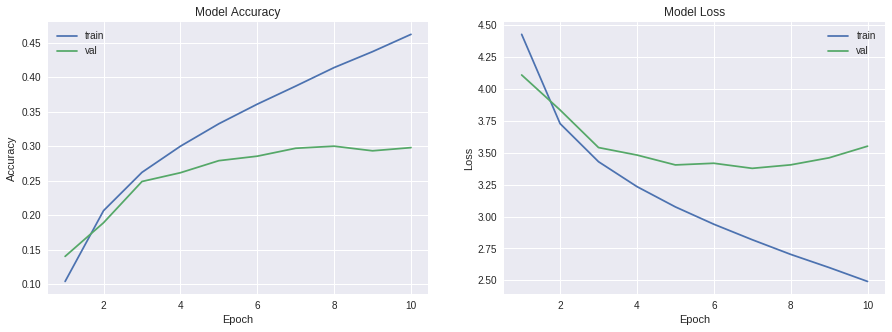

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline

def plot_model_history(model_history):
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    # summarize history for accuracy
    axs[0].plot(range(1,len(model_history.history['acc'])+1),model_history.history['acc'])
    axs[0].plot(range(1,len(model_history.history['val_acc'])+1),model_history.history['val_acc'])
    axs[0].set_title('Model Accuracy')
    axs[0].set_ylabel('Accuracy')
    axs[0].set_xlabel('Epoch')
    axs[0].set_xticks(np.arange(1,len(model_history.history['acc'])+1),len(model_history.history['acc'])/10)
    axs[0].legend(['train', 'val'], loc='best')
    # summarize history for loss
    axs[1].plot(range(1,len(model_history.history['loss'])+1),model_history.history['loss'])
    axs[1].plot(range(1,len(model_history.history['val_loss'])+1),model_history.history['val_loss'])
    axs[1].set_title('Model Loss')
    axs[1].set_ylabel('Loss')
    axs[1].set_xlabel('Epoch')
    axs[1].set_xticks(np.arange(1,len(model_history.history['loss'])+1),len(model_history.history['loss'])/10)
    axs[1].legend(['train', 'val'], loc='best')
    plt.show()
    

plot_model_history(model_16x16)    

# Training Model - 32x32 Image Size (Epoch count : 14; Accuracy : 40.62%)

### *Used 6th epoch weights:*


Training Accuracy - 51.76% 

Validation Accuracy - 40.62%

In [0]:
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,32)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 32, 32, 3)
(10000, 32, 32, 3)


In [0]:
nb_epoch = 10
img_rows = 32
img_cols = 32

In [0]:
X_train, X_test = data_normalization(X_train, X_test)

sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])


model.load_weights("gdrive/My Drive/weights/04032019_2/weights_16x16.0008-0.30.hdf5")

model.summary()

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_32x32.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_32x32.csv"))

callbacks_list = [checkpoint, logger]

model_info_32x32 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, 32, 32, 64)   1728        input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_20 (BatchNo (None, 32, 32, 64)   256         conv2d_21[0][0]                  
__________________________________________________________________________________________________
activation_21 (Activation)      (None, 32,

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 296s 3ms/step - loss: 3.0423 - acc: 0.3519 - val_loss: 3.2069 - val_acc: 0.3334
Epoch 2/10
100000/100000 [==============================] - 290s 3ms/step - loss: 2.7709 - acc: 0.4080 - val_loss: 3.1796 - val_acc: 0.3397
Epoch 3/10
100000/100000 [==============================] - 291s 3ms/step - loss: 2.6078 - acc: 0.4415 - val_loss: 2.9536 - val_acc: 0.3818
Epoch 4/10
100000/100000 [==============================] - 291s 3ms/step - loss: 2.4839 - acc: 0.4697 - val_loss: 3.0969 - val_acc: 0.3683
Epoch 5/10
100000/100000 [==============================] - 291s 3ms/step - loss: 2.3693 - acc: 0.4948 - val_loss: 2.9817 - val_acc: 0.3870
Epoch 6/10
100000/100000 [==============================] - 292s 3ms/step - loss: 2.2708 - acc: 0.5176 - val_loss: 2.9434 - val_acc: 0.4062
Epoch 7/10
100000/100000 [==============================] - 292s 3ms/step - loss: 2.1771 - acc: 0.5374 - val_

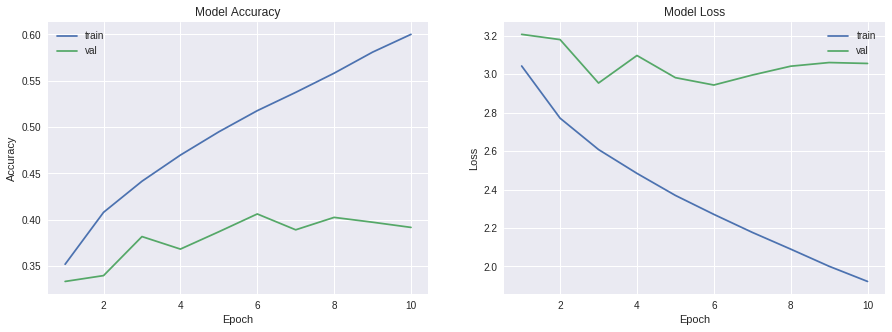

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline

def plot_model_history(model_history):
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    # summarize history for accuracy
    axs[0].plot(range(1,len(model_history.history['acc'])+1),model_history.history['acc'])
    axs[0].plot(range(1,len(model_history.history['val_acc'])+1),model_history.history['val_acc'])
    axs[0].set_title('Model Accuracy')
    axs[0].set_ylabel('Accuracy')
    axs[0].set_xlabel('Epoch')
    axs[0].set_xticks(np.arange(1,len(model_history.history['acc'])+1),len(model_history.history['acc'])/10)
    axs[0].legend(['train', 'val'], loc='best')
    # summarize history for loss
    axs[1].plot(range(1,len(model_history.history['loss'])+1),model_history.history['loss'])
    axs[1].plot(range(1,len(model_history.history['val_loss'])+1),model_history.history['val_loss'])
    axs[1].set_title('Model Loss')
    axs[1].set_ylabel('Loss')
    axs[1].set_xlabel('Epoch')
    axs[1].set_xticks(np.arange(1,len(model_history.history['loss'])+1),len(model_history.history['loss'])/10)
    axs[1].legend(['train', 'val'], loc='best')
    plt.show()
    

plot_model_history(model_info_32x32)    

# Training Model - 64x64 Image Size (Epoch count : 21; Accuracy : 47.23%)

### *Used 6th+1st=7th epoch weights:*


Training Accuracy - 62.52% 

Validation Accuracy - 47.23%

In [0]:
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,64)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 64, 64, 3)
(10000, 64, 64, 3)


In [0]:
nb_epoch = 10
img_rows = 64
img_cols = 64

### Used 6th epoch weights

In [0]:
X_train, X_test = data_normalization(X_train, X_test)
sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)
model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])

model.load_weights("gdrive/My Drive/weights/04032019_2/weights_32x32.0006-0.41.hdf5")

model.summary()

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_64x64.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )

logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_64x64.csv"))

callbacks_list = [checkpoint, logger]


model_64x64 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 64, 64, 3)    0                                            
__________________________________________________________________________________________________
conv2d_41 (Conv2D)              (None, 64, 64, 64)   1728        input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_39 (BatchNo (None, 64, 64, 64)   256         conv2d_41[0][0]                  
__________________________________________________________________________________________________
activation_41 (Activation)      (None, 64,

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 1045s 10ms/step - loss: 2.5216 - acc: 0.4706 - val_loss: 2.7087 - val_acc: 0.4369
Epoch 2/10
100000/100000 [==============================] - 1034s 10ms/step - loss: 2.2926 - acc: 0.5168 - val_loss: 2.7488 - val_acc: 0.4318
Epoch 3/10
100000/100000 [==============================] - 1034s 10ms/step - loss: 2.1674 - acc: 0.5407 - val_loss: 2.6593 - val_acc: 0.4532
Epoch 4/10
100000/100000 [==============================] - 1034s 10ms/step - loss: 2.0731 - acc: 0.5617 - val_loss: 2.6248 - val_acc: 0.4621
Epoch 5/10
100000/100000 [==============================] - 1034s 10ms/step - loss: 1.9971 - acc: 0.5774 - val_loss: 2.6745 - val_acc: 0.4608
Epoch 6/10
100000/100000 [==============================] - 1034s 10ms/step - loss: 1.9205 - acc: 0.5958 - val_loss: 2.5889 - val_acc: 0.4697
Epoch 7/10
100000/100000 [==============================] - 1031s 10ms/step - loss: 1.8464 - acc:

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 35s 3ms/step
Test loss: 2.7128785537719726
Test accuracy: 0.4615


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64.0006-0.47.hdf5")
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 33s 3ms/step
Test loss: 2.588943346786499
Test accuracy: 0.4697


### Used 1st epoch weights

In [0]:
nb_epoch=5
model_64x64 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  


Train on 100000 samples, validate on 10000 samples
Epoch 1/5
100000/100000 [==============================] - 1031s 10ms/step - loss: 1.7914 - acc: 0.6252 - val_loss: 2.5849 - val_acc: 0.4723
Epoch 2/5
100000/100000 [==============================] - 1034s 10ms/step - loss: 1.7260 - acc: 0.6399 - val_loss: 2.8258 - val_acc: 0.4410
Epoch 3/5
  2000/100000 [..............................] - ETA: 16:22 - loss: 1.5696 - acc: 0.6740

KeyboardInterrupt: ignored

# IGNORE : Training which is not included in count

## Training Model - 16X16 Image Size

In [0]:
#@title Default title text
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,16)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 16, 16, 3)
(10000, 16, 16, 3)


In [0]:
nb_epoch = 10
img_rows = 16
img_cols = 16

In [0]:
X_train, X_test = data_normalization(X_train, X_test)

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])

model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64.0004-0.47.hdf5")

model.summary()

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_16x16_2.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )

logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_16x16_2.csv"))

callbacks_list = [checkpoint, logger]


model_16x16_2 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 16, 16, 3)    0                                            
__________________________________________________________________________________________________
conv2d_81 (Conv2D)              (None, 16, 16, 64)   1728        input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_77 (BatchNo (None, 16, 16, 64)   256         conv2d_81[0][0]                  
__________________________________________________________________________________________________
activation_81 (Activation)      (None, 16,

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 113s 1ms/step - loss: 3.8345 - acc: 0.2682 - val_loss: 3.4916 - val_acc: 0.2889
Epoch 2/10
100000/100000 [==============================] - 108s 1ms/step - loss: 3.0594 - acc: 0.3701 - val_loss: 3.2489 - val_acc: 0.3283
Epoch 3/10
100000/100000 [==============================] - 107s 1ms/step - loss: 2.6681 - acc: 0.4304 - val_loss: 3.1800 - val_acc: 0.3426
Epoch 4/10
100000/100000 [==============================] - 107s 1ms/step - loss: 2.4735 - acc: 0.4659 - val_loss: 3.1952 - val_acc: 0.3437
Epoch 5/10
100000/100000 [==============================] - 106s 1ms/step - loss: 2.3225 - acc: 0.4964 - val_loss: 3.2465 - val_acc: 0.3414
Epoch 6/10
100000/100000 [==============================] - 108s 1ms/step - loss: 2.1899 - acc: 0.5244 - val_loss: 3.2996 - val_acc: 0.3418
Epoch 7/10
100000/100000 [==============================] - 108s 1ms/step - loss: 2.0701 - acc: 0.5502 - val_

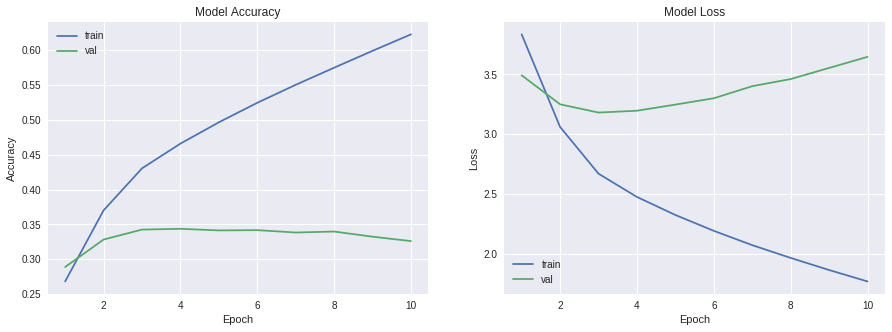

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline

def plot_model_history(model_history):
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    # summarize history for accuracy
    axs[0].plot(range(1,len(model_history.history['acc'])+1),model_history.history['acc'])
    axs[0].plot(range(1,len(model_history.history['val_acc'])+1),model_history.history['val_acc'])
    axs[0].set_title('Model Accuracy')
    axs[0].set_ylabel('Accuracy')
    axs[0].set_xlabel('Epoch')
    axs[0].set_xticks(np.arange(1,len(model_history.history['acc'])+1),len(model_history.history['acc'])/10)
    axs[0].legend(['train', 'val'], loc='best')
    # summarize history for loss
    axs[1].plot(range(1,len(model_history.history['loss'])+1),model_history.history['loss'])
    axs[1].plot(range(1,len(model_history.history['val_loss'])+1),model_history.history['val_loss'])
    axs[1].set_title('Model Loss')
    axs[1].set_ylabel('Loss')
    axs[1].set_xlabel('Epoch')
    axs[1].set_xticks(np.arange(1,len(model_history.history['loss'])+1),len(model_history.history['loss'])/10)
    axs[1].legend(['train', 'val'], loc='best')
    plt.show()
    

plot_model_history(model_16x16_2)    

## 32x32

In [0]:
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,32)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 32, 32, 3)
(10000, 32, 32, 3)


In [0]:
nb_epoch = 10
img_rows = 32
img_cols = 32

In [0]:
X_train, X_test = data_normalization(X_train, X_test)

sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])


model.load_weights("gdrive/My Drive/weights/04032019_2/weights_16x16_2.0004-0.34.hdf5")

model.summary()

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_32x32_2.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_32x32_2.csv"))

callbacks_list = [checkpoint, logger]

model_info_32x32_2 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv2d_101 (Conv2D)             (None, 32, 32, 64)   1728        input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_96 (BatchNo (None, 32, 32, 64)   256         conv2d_101[0][0]                 
__________________________________________________________________________________________________
activation_101 (Activation)     (None, 32,

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 294s 3ms/step - loss: 2.5042 - acc: 0.4624 - val_loss: 2.9850 - val_acc: 0.3840
Epoch 2/10
100000/100000 [==============================] - 287s 3ms/step - loss: 2.2619 - acc: 0.5233 - val_loss: 2.9520 - val_acc: 0.4076
Epoch 3/10
100000/100000 [==============================] - 287s 3ms/step - loss: 2.1379 - acc: 0.5523 - val_loss: 2.9906 - val_acc: 0.4089
Epoch 4/10
100000/100000 [==============================] - 286s 3ms/step - loss: 2.0271 - acc: 0.5810 - val_loss: 3.0225 - val_acc: 0.4010
Epoch 5/10
100000/100000 [==============================] - 286s 3ms/step - loss: 1.9323 - acc: 0.6017 - val_loss: 3.2035 - val_acc: 0.3946
Epoch 6/10
100000/100000 [==============================] - 286s 3ms/step - loss: 1.8440 - acc: 0.6259 - val_loss: 3.1277 - val_acc: 0.4106
Epoch 7/10
100000/100000 [==============================] - 286s 3ms/step - loss: 1.7588 - acc: 0.6481 - val_

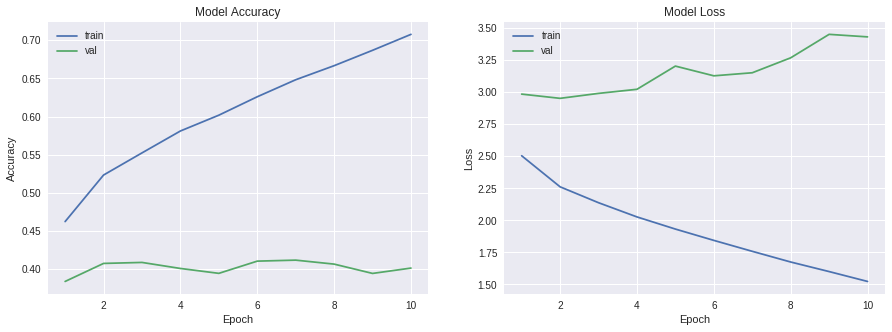

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline

def plot_model_history(model_history):
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    # summarize history for accuracy
    axs[0].plot(range(1,len(model_history.history['acc'])+1),model_history.history['acc'])
    axs[0].plot(range(1,len(model_history.history['val_acc'])+1),model_history.history['val_acc'])
    axs[0].set_title('Model Accuracy')
    axs[0].set_ylabel('Accuracy')
    axs[0].set_xlabel('Epoch')
    axs[0].set_xticks(np.arange(1,len(model_history.history['acc'])+1),len(model_history.history['acc'])/10)
    axs[0].legend(['train', 'val'], loc='best')
    # summarize history for loss
    axs[1].plot(range(1,len(model_history.history['loss'])+1),model_history.history['loss'])
    axs[1].plot(range(1,len(model_history.history['val_loss'])+1),model_history.history['val_loss'])
    axs[1].set_title('Model Loss')
    axs[1].set_ylabel('Loss')
    axs[1].set_xlabel('Epoch')
    axs[1].set_xticks(np.arange(1,len(model_history.history['loss'])+1),len(model_history.history['loss'])/10)
    axs[1].legend(['train', 'val'], loc='best')
    plt.show()
    

plot_model_history(model_info_32x32_2)    

In [0]:
# Save the trained weights and model in .h5 format
model.save_weights("gdrive/My Drive/weights/04032019_2/Assignment4_final_weights.h5")
model.save('gdrive/My Drive/weights/04032019_2/Assignment4_model.h5')

Saved model to disk


## 64 x 64

In [0]:
path='tiny-imagenet-200'
X_train,y_train,X_test,y_test,X_train_filenames=load_images(path,200,64)
print(X_train.shape)
print(X_test.shape)

Loading 200 classes
loading training images...
finished loading training images
loading test images...
finished loading test images10000
(100000, 64, 64, 3)
(10000, 64, 64, 3)


In [0]:
nb_epoch = 10
img_rows = 64
img_cols = 64

In [0]:
X_train, X_test = data_normalization(X_train, X_test)

sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])

model.load_weights("gdrive/My Drive/weights/04032019_2/weights_32x32_2.0007-0.41.hdf5")

model.summary()

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_64x64.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )

logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_64x64.csv"))

callbacks_list = [checkpoint, logger]


model_64x64 = model.fit(X_train, y_train,
              batch_size=batch_size,
              nb_epoch=nb_epoch,
              validation_data=(X_test, y_test),
              shuffle=True,callbacks=callbacks_list)

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            (None, 64, 64, 3)    0                                            
__________________________________________________________________________________________________
conv2d_121 (Conv2D)             (None, 64, 64, 64)   1728        input_7[0][0]                    
__________________________________________________________________________________________________
batch_normalization_115 (BatchN (None, 64, 64, 64)   256         conv2d_121[0][0]                 
__________________________________________________________________________________________________
activation_121 (Activation)     (None, 64,

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:28: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 100000 samples, validate on 10000 samples
Epoch 1/10
100000/100000 [==============================] - 1018s 10ms/step - loss: 2.5631 - acc: 0.4765 - val_loss: 3.0236 - val_acc: 0.4015
Epoch 2/10
100000/100000 [==============================] - 1010s 10ms/step - loss: 2.2788 - acc: 0.5349 - val_loss: 3.0286 - val_acc: 0.3980
Epoch 3/10
100000/100000 [==============================] - 1010s 10ms/step - loss: 2.1407 - acc: 0.5628 - val_loss: 2.8110 - val_acc: 0.4526
Epoch 4/10
100000/100000 [==============================] - 1009s 10ms/step - loss: 2.0293 - acc: 0.5870 - val_loss: 2.7481 - val_acc: 0.4564
Epoch 5/10
100000/100000 [==============================] - 1010s 10ms/step - loss: 1.9440 - acc: 0.6048 - val_loss: 2.7087 - val_acc: 0.4727
Epoch 6/10
100000/100000 [==============================] - 1010s 10ms/step - loss: 1.8566 - acc: 0.6251 - val_loss: 2.7537 - val_acc: 0.4591
Epoch 7/10
100000/100000 [==============================] - 1009s 10ms/step - loss: 1.7875 - acc:

KeyboardInterrupt: ignored

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 33s 3ms/step
Test loss: 2.875894408035278
Test accuracy: 0.4497


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_16x16_2.0007-0.35.hdf5")

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 32s 3ms/step
Test loss: 9.96509559173584
Test accuracy: 0.005


# Evaluate model

### Run if you want to initialize model

In [0]:
X_train, X_test = data_normalization(X_train, X_test)

sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


### Evaluating Validation accuracy

In [0]:
model.load_weights("gdrive/My Drive/04032019_2/04032019_2/weights_64x64.0001-0.47.hdf5")
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 36s 4ms/step
Test loss: 2.584915778160095
Test accuracy: 0.4723


### Evaluating Training accuracy

In [0]:
score = model.evaluate(X_train, y_train, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

100000/100000 [==============================] - 331s 3ms/step
Test loss: 1.786564648590088
Test accuracy: 0.62119


In [0]:
Y_test = np.argmax(y_test, axis=1)
y_prob = model.predict(X_test) 
y_classes = y_prob.argmax(axis=-1)

correct_indices = np.nonzero(y_classes == Y_test)[0] 
incorrect_indices = np.nonzero(y_classes != Y_test)[0] 
print(len(correct_indices)," classified correctly") 
print(len(incorrect_indices)," classified incorrectly")

4723  classified correctly
5277  classified incorrectly


In [0]:
actual = np.argmax(y_train, axis=1) # Convert one-hot to index
pred = model.predict(X_train, batch_size=512, verbose=1)
prediction = np.argmax(pred, axis=1)

incorrect_indices = np.nonzero(actual != prediction)[0] 
incorrect_indices

100000/100000 [==============================] - 337s 3ms/step


array([    1,     2,     3, ..., 99990, 99992, 99996])

# Confusion Matrix

In [0]:
from sklearn.metrics import classification_report
import numpy as np

Y_test = np.argmax(y_test, axis=1) # Convert one-hot to index
y_pred = model.predict(X_test)
y_pred = np.argmax(y_pred, axis=1)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           0       0.75      0.30      0.43        50
           1       0.35      0.14      0.20        50
           2       0.88      0.70      0.78        50
           3       0.56      0.36      0.44        50
           4       0.41      0.62      0.50        50
           5       0.54      0.74      0.63        50
           6       0.15      0.48      0.23        50
           7       0.38      0.50      0.43        50
           8       0.48      0.44      0.46        50
           9       0.48      0.32      0.39        50
          10       0.26      0.44      0.33        50
          11       0.67      0.44      0.53        50
          12       0.36      0.76      0.49        50
          13       0.22      0.76      0.35        50
          14       0.57      0.24      0.34        50
          15       0.28      0.16      0.20        50
          16       0.19      0.46      0.27        50
          17       0.47    

# Generate file with 200 classes with labels

In [0]:
!ls

classes_tinyimagenet.txt  sample_data	     tiny-imagenet-200.zip
gdrive			  tiny-imagenet-200


In [0]:
AnnotationsPath = './tiny-imagenet-200/wnids.txt'
AnnotationsFile = open(AnnotationsPath, 'r')
AnnotationsContents = AnnotationsFile.read()
Annotations = {}
f= open("classes_tinyimagenet.txt","a+")

valAnnotationsPath = './tiny-imagenet-200/words.txt'
valAnnotationsFile = open(valAnnotationsPath, 'r')
valAnnotationsContents = valAnnotationsFile.read()
valAnnotations = {}

for line in AnnotationsContents.splitlines():
  for line1 in valAnnotationsContents.splitlines():
    pieces = line1.split("\t")
    if line == pieces[0]:
      f.write(line + " " + pieces[1] + "\n")
	  
	  
from google.colab import files
files.download('classes_tinyimagenet.txt')

# seperate misclassified images

In [0]:
!mkdir tinyimagenet_rebuilt
!mkdir tinyimagenet_rebuilt/train/
!mkdir tinyimagenet_rebuilt/val/

In [0]:
!ls tinyimagenet_rebuilt/train/n01443537

In [0]:
import shutil, os
actual = np.argmax(y_train, axis=1)
prediction=[]
accuracy=[]
TruePred=[]
path='tiny-imagenet-200/train/'
img_path = 'tinyimagenet_rebuilt/train/'


for idx, val in enumerate(X_train):
  val = np.expand_dims(val, axis=0)
  pred = model.predict(val)
  predicted_value = np.argmax(pred, axis=1)
  prediction.append(predicted_value)
  accuracy.append(np.amax(pred, axis=1)*100)
  if actual[idx] != predicted_value:
    TruePred.append('0')
    filename = (X_train_filenames[idx].split('/'))[-1]
    foldername = (filename.split('_'))[0]
    dirName = img_path + foldername
    if not os.path.exists(dirName):
      os.mkdir(dirName)
    shutil.copy(path + foldername + '/images/' + filename, dirName + '/' + filename)
  else:
    TruePred.append('1')

In [0]:
!zip -r -q incorrectPredictions.zip tinyimagenet_rebuilt
shutil.copyfile('incorrectPredictions.zip','gdrive/My Drive/incorrectPredictions.zip')


zip error: Nothing to do! (try: zip -r -q incorrectPredictions.zip . -i tinyimagenet_rebuilt)


'gdrive/My Drive/incorrectPredictions.zip'

In [0]:
!ls

gdrive			  sample_data	     tiny-imagenet-200.zip
incorrectPredictions.zip  tiny-imagenet-200


In [0]:
!find tinyimagenet_rebuilt/train/ -type f | wc -l

37881


In [0]:
dictionary={'FileName':X_train_filenames, 'PredictedClass':prediction, 'ActualClass':actual, 'Accuracy':accuracy, 'Matching':TruePred}
df = pd.DataFrame(dictionary)
# from IPython.display import display
# display(df)
df.head(15)

,Accuracy,ActualClass,FileName,Matching,PredictedClass
0,[45.529034],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
1,[33.17741],0,tiny-imagenet-200/train/n03085013/images/n0308...,0,[17]
2,[26.485304],0,tiny-imagenet-200/train/n03085013/images/n0308...,0,[145]
3,[19.812826],0,tiny-imagenet-200/train/n03085013/images/n0308...,0,[10]
4,[63.09683],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
5,[83.00976],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
6,[52.151382],0,tiny-imagenet-200/train/n03085013/images/n0308...,0,[119]
7,[98.31245],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
8,[18.296265],0,tiny-imagenet-200/train/n03085013/images/n0308...,0,[94]
9,[38.47886],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]


In [0]:
df.to_csv('gdrive/My Drive/weights/Prediction.csv')

In [0]:
correctpredictions = df.drop(df[df.Matching == '0'].index)
correctpredictions.head(15)
# display(correctpredictions)

,Accuracy,ActualClass,FileName,Matching,PredictedClass
0,[45.529034],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
4,[63.09683],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
5,[83.00976],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
7,[98.31245],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
9,[38.47886],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
10,[62.680977],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
11,[56.163086],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
12,[78.90923],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
13,[33.45655],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]
14,[56.468414],0,tiny-imagenet-200/train/n03085013/images/n0308...,1,[0]


# Download from google drive

In [0]:
!rm -rf tinyimagenet_rebuilt

In [0]:
!ls /content

gdrive	sample_data	   tiny-imagenet-200.zip
-q	tiny-imagenet-200  tinyimagenet_rebuilt


In [0]:
!unzip -q gdrive/'My Drive'/incorrectPredictions.zip

In [0]:
!find tinyimagenet_rebuilt/train/ -type f | wc -l

37881


# Data Augmentation

In [0]:
import os
import cv2
# import imgaug as ia
from imgaug import augmenters as iaa

trainPath='tinyimagenet_rebuilt/train'
for sChild in os.listdir(trainPath):
  sChildPath = os.path.join(trainPath,sChild)
  for c in os.listdir(sChildPath):
    image = cv2.imread(os.path.join(sChildPath,c))
#     noise = iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.01*255), per_channel=0.5)  
#     noise_image = noise.augment_image(image)
#     cv2.imwrite(sChildPath+"/noise_"+c,noise_image)
    
    dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
    dropout_image = dropout.augment_image(image)
    cv2.imwrite(sChildPath+"/dropout_"+c,dropout_image)

    flip = iaa.Fliplr(0.5)
    flip_image = flip.augment_image(image)
    cv2.imwrite(sChildPath+"/flip_"+c,flip_image)
    
#     contrast = iaa.SigmoidContrast(gain=8.1, cutoff=0.5)
#     contrast_image = contrast.augment_image(image)
#     cv2.imwrite(sChildPath+"/contrast_"+c,contrast_image)
    
    blur = iaa.MotionBlur(angle=0, k=3)
    blur_image = blur.augment_image(image)
    cv2.imwrite(sChildPath+"/blur_"+c,blur_image)
    
    affine = iaa.Affine(rotate=(-60, 60))
    affine_image = affine.augment_image(image)
    cv2.imwrite(sChildPath+"/affine_"+c,affine_image)
    
    crop = iaa.Crop(percent=(0, 0.1))
    crop_image = crop.augment_image(image)
    cv2.imwrite(sChildPath+"/crop_"+c,crop_image)
    
#     pad = iaa.Pad(px=(8,0,0, 32)) # crop images from each side by 0 to 16px (randomly chosen)
#     pad_image = pad.augment_image(image)
#     cv2.imwrite(sChildPath+"/pad_"+c,pad_image)

In [0]:
!find tinyimagenet_rebuilt/train/ -type f | wc -l

227286


# Second set of Augmentations

In [0]:
import os
import cv2
# import imgaug as ia
from imgaug import augmenters as iaa

trainPath='tinyimagenet_rebuilt/train'
for sChild in os.listdir(trainPath):
  sChildPath = os.path.join(trainPath,sChild)
  for c in os.listdir(sChildPath):
    image = cv2.imread(os.path.join(sChildPath,c))
    noise = iaa.AdditiveGaussianNoise(scale=(0.0, 0.12*255))  
    noise_image = noise.augment_image(image)
    cv2.imwrite(sChildPath+"/noise_"+c,noise_image)
    
    dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
    dropout_image = dropout.augment_image(image)
    cv2.imwrite(sChildPath+"/dropout_"+c,dropout_image)

    flip = iaa.Fliplr(1.0)
    flip_image = flip.augment_image(image)
    cv2.imwrite(sChildPath+"/flip_"+c,flip_image)
    
    contrast = iaa.SigmoidContrast(gain=11.1, cutoff=0.5)
    contrast_image = contrast.augment_image(image)
    cv2.imwrite(sChildPath+"/contrast_"+c,contrast_image)
    
    blur = iaa.GaussianBlur(sigma=(0, 1.5))
    blur_image = blur.augment_image(image)
    cv2.imwrite(sChildPath+"/blur_"+c,blur_image)
    
    affine = iaa.Affine(rotate=(-45, 45))
    affine_image = affine.augment_image(image)
    cv2.imwrite(sChildPath+"/affine_"+c,affine_image)
    
    crop = iaa.Crop(percent=(0, 0.3))
    crop_image = crop.augment_image(image)
    cv2.imwrite(sChildPath+"/crop_"+c,crop_image)
    
#     pad = iaa.Pad(px=(8,0,0, 32)) # crop images from each side by 0 to 16px (randomly chosen)
#     pad_image = pad.augment_image(image)
#     cv2.imwrite(sChildPath+"/pad_"+c,pad_image)

In [0]:
!find tinyimagenet_rebuilt/train/ -type f | wc -l

303048


In [0]:
!zip -r -q tinyimagenet_rebuilt_3aug.zip tinyimagenet_rebuilt
copyfile('tinyimagenet_rebuilt_3aug.zip','gdrive/My Drive/tinyimagenet_rebuilt_3aug.zip')

In [0]:
!zip -r -q validation.zip tiny-imagenet-200/val
shutil.copyfile('validation.zip','gdrive/My Drive/validation.zip')

In [0]:
!unzip gdrive/'My Drive'/validation.zip

# View generated images using data augmentation

In [0]:
!ls tinyimagenet_rebuilt/train/n01443537/

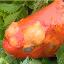

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/n01443537_125.JPEG'))

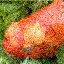

In [0]:
from IPython.display import display, Image
image = cv2.imread('tinyimagenet_rebuilt/train/n01443537/n01443537_125.JPEG')
noise = iaa.AdditiveGaussianNoise(scale=(0.0, 0.10*255))  
noise_image = noise.augment_image(image)
cv2.imwrite("tinyimagenet_rebuilt/train/n01443537/crop_n01443537_125.JPEG",noise_image)

display(Image(filename='tinyimagenet_rebuilt/train/n01443537/crop_n01443537_125.JPEG'))


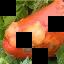

In [0]:
from IPython.display import display, Image
image = cv2.imread('tinyimagenet_rebuilt/train/n01443537/n01443537_125.JPEG')
dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
dropout_image = dropout.augment_image(image)
cv2.imwrite("tinyimagenet_rebuilt/train/n01443537/crop_n01443537_125.JPEG",dropout_image)

display(Image(filename='tinyimagenet_rebuilt/train/n01443537/crop_n01443537_125.JPEG'))

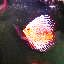

In [0]:
from IPython.display import display, Image
image = cv2.imread('tinyimagenet_rebuilt/train/n01443537/n01443537_191.JPEG')
dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
dropout_image = dropout.augment_image(image)
cv2.imwrite("tinyimagenet_rebuilt/train/n01443537/crop_n01443537_191.JPEG",dropout_image)

display(Image(filename='tinyimagenet_rebuilt/train/n01443537/crop_n01443537_191.JPEG'))

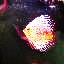

In [0]:
from IPython.display import display, Image
image = cv2.imread('tinyimagenet_rebuilt/train/n01443537/n01443537_191.JPEG')
dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
dropout_image = dropout.augment_image(image)
cv2.imwrite("tinyimagenet_rebuilt/train/n01443537/crop_n01443537_191.JPEG",dropout_image)

display(Image(filename='tinyimagenet_rebuilt/train/n01443537/crop_n01443537_191.JPEG'))

In [0]:
!ls tinyimagenet_rebuilt/train/n01443537

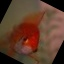

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/affine_n01443537_135.JPEG'))

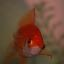

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/blur_n01443537_135.JPEG'))

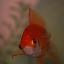

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/flip_n01443537_135.JPEG'))

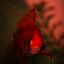

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/contrast_n01443537_135.JPEG'))

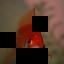

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/dropout_n01443537_135.JPEG'))

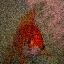

In [0]:
from IPython.display import display, Image
display(Image(filename='tinyimagenet_rebuilt/train/n01443537/noise_n01443537_135.JPEG'))

# Add correct predictions in training dataset

In [0]:
dest_path = 'tinyimagenet_rebuilt/train'
for files in correctpredictions['FileName']:
  #print(dest_path+files[23:34]+files[41:])
  shutil.copyfile(files, dest_path+files[23:34]+files[41:])

In [0]:
!find tinyimagenet_rebuilt/train/ -type f | wc -l

365167


In [0]:
!mkdir correct_predidtions

correct_predidtions  sample_data	tiny-imagenet-200.zip
gdrive		     tiny-imagenet-200	tinyimagenet_rebuilt


In [0]:
dest_path = 'correct_predidtions/'
for files in correctpredictions['FileName']:
  #print(dest_path+files[23:34]+files[41:])
  shutil.copyfile(files, dest_path+files[41:])

In [0]:
!find correct_predidtions/ -type f | wc -l

62119


In [0]:
!zip -r -q correct_predidtions.zip correct_predidtions
shutil.copyfile('correct_predidtions.zip','gdrive/My Drive/correct_predidtions.zip')

'gdrive/My Drive/correct_predidtions.zip'

# Validation dataset

In [0]:
import shutil, os

valPath = './tiny-imagenet-200/val/val_annotations.txt'
valFile = open(valPath, 'r')
valContents = valFile.read()
path = './tiny-imagenet-200/val/images/'

for line in valContents.splitlines():
  pieces = line.strip().split()
  #print(pieces[1])
  dirName = path + pieces[1] + '/'
  if not os.path.exists(dirName):
    os.mkdir(dirName)
  actualpath = path + pieces[0]
  shutil.move(actualpath, dirName + pieces[0])

In [0]:
!ls tiny-imagenet-200/val/images/n01443537

val_1230.JPEG  val_2946.JPEG  val_4890.JPEG  val_6900.JPEG  val_886.JPEG
val_1267.JPEG  val_3419.JPEG  val_5085.JPEG  val_7088.JPEG  val_8905.JPEG
val_1284.JPEG  val_3543.JPEG  val_5967.JPEG  val_7268.JPEG  val_8908.JPEG
val_1551.JPEG  val_3545.JPEG  val_6065.JPEG  val_7281.JPEG  val_9130.JPEG
val_1640.JPEG  val_3609.JPEG  val_611.JPEG   val_7930.JPEG  val_9215.JPEG
val_1917.JPEG  val_3772.JPEG  val_651.JPEG   val_8095.JPEG  val_9398.JPEG
val_2046.JPEG  val_4153.JPEG  val_653.JPEG   val_8197.JPEG  val_9467.JPEG
val_2086.JPEG  val_4385.JPEG  val_6854.JPEG  val_8481.JPEG  val_9506.JPEG
val_2253.JPEG  val_4558.JPEG  val_6874.JPEG  val_8577.JPEG  val_9560.JPEG
val_2337.JPEG  val_4653.JPEG  val_68.JPEG    val_8585.JPEG  val_9949.JPEG


# Training Model - 64x64 Image Size with Augmented Data (Epoch Count : 28; Accuracy : 47.24%)

### *Used 7th epoch weights:*


Training Accuracy - 60.57%

Validation Accuracy - 47.24%


In [0]:
nb_epoch = 5
img_rows = 64
img_cols = 64
batch_size = 100

In [0]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator()

train_generator = train_datagen.flow_from_directory(
                        directory='tinyimagenet_rebuilt/train/',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=True,
                        class_mode='categorical')

val_datagen = ImageDataGenerator()

val_generator = val_datagen.flow_from_directory(
                        directory='tiny-imagenet-200/val/images',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=False,
                        class_mode='categorical')


Found 365167 images belonging to 200 classes.
Found 10000 images belonging to 200 classes.


In [0]:
nb_train_samples=365167
nb_val_samples=10000

In [0]:
from keras.callbacks import *

class CyclicLR(Callback):
    """This callback implements a cyclical learning rate policy (CLR).
    The method cycles the learning rate between two boundaries with
    some constant frequency, as detailed in this paper (https://arxiv.org/abs/1506.01186).
    The amplitude of the cycle can be scaled on a per-iteration or 
    per-cycle basis.
    This class has three built-in policies, as put forth in the paper.
    "triangular":
        A basic triangular cycle w/ no amplitude scaling.
    "triangular2":
        A basic triangular cycle that scales initial amplitude by half each cycle.
    "exp_range":
        A cycle that scales initial amplitude by gamma**(cycle iterations) at each 
        cycle iteration.
    For more detail, please see paper.
    
    # Example
        ```python
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., mode='triangular')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```
    
    Class also supports custom scaling functions:
        ```python
            clr_fn = lambda x: 0.5*(1+np.sin(x*np.pi/2.))
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., scale_fn=clr_fn,
                                scale_mode='cycle')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```    
    # Arguments
        base_lr: initial learning rate which is the
            lower boundary in the cycle.
        max_lr: upper boundary in the cycle. Functionally,
            it defines the cycle amplitude (max_lr - base_lr).
            The lr at any cycle is the sum of base_lr
            and some scaling of the amplitude; therefore 
            max_lr may not actually be reached depending on
            scaling function.
        step_size: number of training iterations per
            half cycle. Authors suggest setting step_size
            2-8 x training iterations in epoch.
        mode: one of {triangular, triangular2, exp_range}.
            Default 'triangular'.
            Values correspond to policies detailed above.
            If scale_fn is not None, this argument is ignored.
        gamma: constant in 'exp_range' scaling function:
            gamma**(cycle iterations)
        scale_fn: Custom scaling policy defined by a single
            argument lambda function, where 
            0 <= scale_fn(x) <= 1 for all x >= 0.
            mode paramater is ignored 
        scale_mode: {'cycle', 'iterations'}.
            Defines whether scale_fn is evaluated on 
            cycle number or cycle iterations (training
            iterations since start of cycle). Default is 'cycle'.
    """

    def __init__(self, base_lr=0.001, max_lr=0.006, step_size=2000., mode='triangular',
                 gamma=1., scale_fn=None, scale_mode='cycle'):
        super(CyclicLR, self).__init__()

        self.base_lr = base_lr
        self.max_lr = max_lr
        self.step_size = step_size
        self.mode = mode
        self.gamma = gamma
        if scale_fn == None:
            if self.mode == 'triangular':
                self.scale_fn = lambda x: 1.
                self.scale_mode = 'cycle'
            elif self.mode == 'triangular2':
                self.scale_fn = lambda x: 1/(2.**(x-1))
                self.scale_mode = 'cycle'
            elif self.mode == 'exp_range':
                self.scale_fn = lambda x: gamma**(x)
                self.scale_mode = 'iterations'
        else:
            self.scale_fn = scale_fn
            self.scale_mode = scale_mode
        self.clr_iterations = 0.
        self.trn_iterations = 0.
        self.history = {}

        self._reset()

    def _reset(self, new_base_lr=None, new_max_lr=None,
               new_step_size=None):
        """Resets cycle iterations.
        Optional boundary/step size adjustment.
        """
        if new_base_lr != None:
            self.base_lr = new_base_lr
        if new_max_lr != None:
            self.max_lr = new_max_lr
        if new_step_size != None:
            self.step_size = new_step_size
        self.clr_iterations = 0.
        
    def clr(self):
        cycle = np.floor(1+self.clr_iterations/(2*self.step_size))
        x = np.abs(self.clr_iterations/self.step_size - 2*cycle + 1)
        if self.scale_mode == 'cycle':
            return self.base_lr + (self.max_lr-self.base_lr)*np.maximum(0, (1-x))*self.scale_fn(cycle)
        else:
            return self.base_lr + (self.max_lr-self.base_lr)*np.maximum(0, (1-x))*self.scale_fn(self.clr_iterations)
        
    def on_train_begin(self, logs={}):
        logs = logs or {}

        if self.clr_iterations == 0:
            K.set_value(self.model.optimizer.lr, self.base_lr)
        else:
            K.set_value(self.model.optimizer.lr, self.clr())        
            
    def on_batch_end(self, epoch, logs=None):
        
        logs = logs or {}
        self.trn_iterations += 1
        self.clr_iterations += 1

        self.history.setdefault('lr', []).append(K.get_value(self.model.optimizer.lr))
        self.history.setdefault('iterations', []).append(self.trn_iterations)

        for k, v in logs.items():
            self.history.setdefault(k, []).append(v)
        
        K.set_value(self.model.optimizer.lr, self.clr())

In [0]:
sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)
clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                        step_size=2000., mode='triangular2')

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_64x64_Aug.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_64x64_Aug.csv"))

callbacks_list = [clr, checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(0.1),
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


### Used 4th epoch weights (Accuracy : 45.25%)

In [0]:
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Epoch 1/10
2894/2894 [==============================] - 2971s 1s/step - loss: 4.1690 - acc: 0.1542 - val_loss: 3.5290 - val_acc: 0.2616
Epoch 2/10
2894/2894 [==============================] - 2963s 1s/step - loss: 3.2055 - acc: 0.2960 - val_loss: 3.0945 - val_acc: 0.3472
Epoch 3/10
2894/2894 [==============================] - 2961s 1s/step - loss: 2.9028 - acc: 0.3585 - val_loss: 2.5454 - val_acc: 0.4473
Epoch 4/10
2894/2894 [==============================] - 2954s 1s/step - loss: 2.6044 - acc: 0.4206 - val_loss: 2.5424 - val_acc: 0.4525
Epoch 5/10
2430/2894 [========================>.....] - ETA: 7:47 - loss: 2.2750 - acc: 0.4947

In [0]:
model.load_weights("gdrive/My Drive/04032019/weights_64x64_Aug.0004-0.45.hdf5")

### Used 3rd epoch weights (Accuracy : 47.24%)

In [0]:
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Instructions for updating:
Use tf.cast instead.
Epoch 1/5
2894/2894 [==============================] - 2849s 985ms/step - loss: 2.9017 - acc: 0.3707 - val_loss: 3.3278 - val_acc: 0.3349
Epoch 2/5
2894/2894 [==============================] - 2842s 982ms/step - loss: 2.5726 - acc: 0.4440 - val_loss: 3.1082 - val_acc: 0.3840
Epoch 3/5
2894/2894 [==============================] - 2841s 982ms/step - loss: 2.3913 - acc: 0.4871 - val_loss: 2.5932 - val_acc: 0.4724
Epoch 4/5
2894/2894 [==============================] - 2831s 978ms/step - loss: 2.1458 - acc: 0.5399 - val_loss: 2.6493 - val_acc: 0.4720
Epoch 5/5
2894/2894 [==============================] - 2837s 980ms/step - loss: 1.8745 - acc: 0.6057 - val_loss: 2.7761 - val_acc: 0.4527


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64_Aug.0003-0.47.hdf5")

In [0]:
model.evaluate_generator(generator=val_generator, steps=100)

[2.5931601691246033, 0.47239999994635584]

# Second set of Training Model - 64x64 Image Size with Augmented Data (Epoch Count : 38; Accuracy : 53.52%)

### *Used 9th epoch weights:*


Training Accuracy - 70.81%

Validation Accuracy - 53.52%

In [0]:
nb_epoch = 7
img_rows = 64
img_cols = 64
batch_size = 100

In [0]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator()

train_generator = train_datagen.flow_from_directory(
                        directory='tinyimagenet_rebuilt/train/',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=True,
                        class_mode='categorical')

val_datagen = ImageDataGenerator()

val_generator = val_datagen.flow_from_directory(
                        directory='tiny-imagenet-200/val/images',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=False,
                        class_mode='categorical')

Found 365167 images belonging to 200 classes.
Found 10000 images belonging to 200 classes.


In [0]:
nb_train_samples=365167
nb_val_samples=10000

In [0]:
sgd = optimizers.SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=True)
clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                        step_size=1000., mode='triangular2')

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_32x32_Aug.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_32x32_Aug.csv"))

callbacks_list = [clr, checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(0.1),
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64_Aug.0003-0.47.hdf5")
model.evaluate_generator(generator=val_generator, steps=100)

[2.593160136938095, 0.47239999994635584]

### Used 4th epoch weights (Accuracy : 47.06%)

In [0]:
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Instructions for updating:
Use tf.cast instead.
Epoch 1/7
3651/3651 [==============================] - 3641s 997ms/step - loss: 2.9012 - acc: 0.3855 - val_loss: 2.7193 - val_acc: 0.4469
Epoch 2/7
3651/3651 [==============================] - 3612s 989ms/step - loss: 2.4510 - acc: 0.4768 - val_loss: 2.6205 - val_acc: 0.4611
Epoch 3/7
3651/3651 [==============================] - 3603s 987ms/step - loss: 2.1769 - acc: 0.5346 - val_loss: 2.6434 - val_acc: 0.4639
Epoch 4/7
3651/3651 [==============================] - 3604s 987ms/step - loss: 2.0174 - acc: 0.5699 - val_loss: 2.6731 - val_acc: 0.4706
Epoch 5/7
3651/3651 [==============================] - 3595s 985ms/step - loss: 1.9089 - acc: 0.5945 - val_loss: 2.7720 - val_acc: 0.4591
Epoch 6/7
3651/3651 [==============================] - 3608s 988ms/step - loss: 1.8291 - acc: 0.6127 - val_loss: 2.7634 - val_acc: 0.4558
Epoch 7/7
  16/3651 [..............................] - ETA: 58:25 - loss: 1.7719 - acc: 0.6214

KeyboardInterrupt: ignored

In [0]:
sgd = optimizers.SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=True)
clr = CyclicLR(base_lr=0.0001, max_lr=0.0006,
                        step_size=1000., mode='triangular2')

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_64x64_Aug.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_64x64_Aug.csv"))

callbacks_list = [clr, checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0),
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_32x32_Aug.0004-0.47.hdf5")
model.evaluate_generator(generator=val_generator, steps=100)

[2.673108786344528, 0.47060000136494634]

### Used 3rd epoch weights (Accuracy : 53.44%)

In [0]:
nb_epoch = 3
batch_size = 200
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Epoch 1/3
1825/1825 [==============================] - 1808s 991ms/step - loss: 1.7288 - acc: 0.6486 - val_loss: 2.3173 - val_acc: 0.5256
Epoch 2/3
1825/1825 [==============================] - 1798s 985ms/step - loss: 1.6747 - acc: 0.6620 - val_loss: 2.6323 - val_acc: 0.4786
Epoch 3/3
1825/1825 [==============================] - 1800s 986ms/step - loss: 1.5644 - acc: 0.6930 - val_loss: 2.3121 - val_acc: 0.5344


### Used 2nd epoch weights (Accuracy : 53.52%)

In [0]:
nb_epoch = 5
batch_size = 200
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Epoch 1/5
1825/1825 [==============================] - 1805s 989ms/step - loss: 1.5638 - acc: 0.6921 - val_loss: 2.6484 - val_acc: 0.4828
Epoch 2/5
1825/1825 [==============================] - 1800s 987ms/step - loss: 1.5055 - acc: 0.7081 - val_loss: 2.3031 - val_acc: 0.5352
Epoch 3/5
1825/1825 [==============================] - 1800s 986ms/step - loss: 1.5149 - acc: 0.7041 - val_loss: 2.6381 - val_acc: 0.4770
Epoch 4/5
1825/1825 [==============================] - 1799s 986ms/step - loss: 1.4696 - acc: 0.7169 - val_loss: 2.3165 - val_acc: 0.5328
Epoch 5/5
   4/1825 [..............................] - ETA: 29:35 - loss: 1.4114 - acc: 0.7075

KeyboardInterrupt: ignored

# Get incorrect prediction in Validation set

In [0]:
val_generator.reset()
pred=model.predict_generator(val_generator,verbose=1,steps=100)

100/100 [==============================] - 32s 316ms/step


In [0]:
predicted_class_indices=np.argmax(pred,axis=1)

In [0]:
labels = (val_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]

In [0]:
filenames=val_generator.filenames
results=pd.DataFrame({"Filename":filenames,
                      "Predictions":predictions})
results.to_csv("results.csv",index=False)

In [0]:
filenames=val_generator.filenames
results=pd.DataFrame({"Filename":filenames,
                      "Predictions":predictions,
                      "ActualClass":filenames.strip()})
results.to_csv("results.csv",index=False)

In [0]:
files.download('results.csv')

# Ignore

### Add more augmentations

In [0]:
!ls

sample_data


In [0]:
!unzip -q gdrive/'My Drive'/incorrectPredictions_new.zip

In [0]:
!find incorrectPredictions/tinyimagenet_aug/train/ -type f | wc -l

find: ‘incorrectPredictions/tinyimagenet_aug/train/’: No such file or directory
0


In [0]:
!ls incorrectPredictions/tinyimagenet_aug/train

n01443537  n02113799  n02509815  n02988304  n03670208  n04146614  n04596742
n01629819  n02123045  n02666196  n02999410  n03706229  n04149813  n04597913
n01641577  n02123394  n02669723  n03014705  n03733131  n04179913  n06596364
n01644900  n02124075  n02699494  n03026506  n03763968  n04251144  n07579787
n01698640  n02125311  n02730930  n03042490  n03770439  n04254777  n07583066
n01742172  n02129165  n02769748  n03085013  n03796401  n04259630  n07614500
n01768244  n02132136  n02788148  n03089624  n03804744  n04265275  n07615774
n01770393  n02165456  n02791270  n03100240  n03814639  n04275548  n07695742
n01774384  n02190166  n02793495  n03126707  n03837869  n04285008  n07711569
n01774750  n02206856  n02795169  n03160309  n03838899  n04311004  n07715103
n01784675  n02226429  n02802426  n03179701  n03854065  n04328186  n07720875
n01855672  n02231487  n02808440  n03201208  n03891332  n04356056  n07734744
n01882714  n02233338  n02814533  n03250847  n03902125  n04366367  n07747607
n01910747  n

In [0]:
import os
import cv2
# import imgaug as ia
from imgaug import augmenters as iaa

trainPath='tinyimagenet_rebuilt/train'
sourcepath='incorrectPredictions/tinyimagenet_aug/train'
for sChild in os.listdir(sourcepath):
  sChildPath = os.path.join(sourcepath,sChild)
  for c in os.listdir(sourcepath):
    image = cv2.imread(os.path.join(sChildPath,c))
    noise = iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.10*255))  
    noise_image = noise.augment_image(image)
    cv2.imwrite(os.path.join(trainPath,sChild)+"/noise_"+c,noise_image)
    
#     dropout = iaa.CoarseDropout(p=0.2, size_percent=0.02)
#     dropout_image = dropout.augment_image(image)
#     cv2.imwrite(sChildPath+"/dropout_"+c,dropout_image)

#     flip = iaa.Fliplr(0.5)
#     flip_image = flip.augment_image(image)
#     cv2.imwrite(sChildPath+"/flip_"+c,flip_image)
    
#     contrast = iaa.SigmoidContrast(gain=8.1, cutoff=0.5)
#     contrast_image = contrast.augment_image(image)
#     cv2.imwrite(sChildPath+"/contrast_"+c,contrast_image)
    
    blur = iaa.GaussianBlur(sigma=(0, 1.0))
    blur_image = blur.augment_image(image)
    cv2.imwrite(os.path.join(trainPath,sChild)+"/blur_"+c,blur_image)
    
#     affine = iaa.Affine(rotate=(-60, 60))
#     affine_image = affine.augment_image(image)
#     cv2.imwrite(sChildPath+"/affine_"+c,affine_image)
    
#     crop = iaa.Crop(percent=(0, 0.1))
#     crop_image = crop.augment_image(image)
#     cv2.imwrite(sChildPath+"/crop_"+c,crop_image)
    
#     pad = iaa.Pad(px=(8,0,0, 32)) # crop images from each side by 0 to 16px (randomly chosen)
#     pad_image = pad.augment_image(image)
#     cv2.imwrite(sChildPath+"/pad_"+c,pad_image)

FileNotFoundError: ignored

## Predictions

In [0]:
!ls 

In [0]:
pred=model.predict_generator(val_generator,verbose=1,steps=nb_val_samples // batch_size)
predicted_class_indices=np.argmax(pred,axis=1)

100/100 [==============================] - 31s 314ms/step


In [0]:
labels = (val_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]

In [0]:
filenames=val_generator.filenames
results=pd.DataFrame({"Filename":filenames,
                      "Predictions":predictions})
results.to_csv("results.csv",index=False)

In [0]:
from google.colab import files
files.download('results.csv')

In [0]:
results.head(15)

,Filename,Predictions
0,n01443537/val_1230.JPEG,n03388043
1,n01443537/val_1267.JPEG,n09332890
2,n01443537/val_1284.JPEG,n02837789
3,n01443537/val_1551.JPEG,n04251144
4,n01443537/val_1640.JPEG,n04366367
5,n01443537/val_1917.JPEG,n09332890
6,n01443537/val_2046.JPEG,n09428293
7,n01443537/val_2086.JPEG,n04251144
8,n01443537/val_2253.JPEG,n09428293
9,n01443537/val_2337.JPEG,n09332890


In [0]:
Y_test.shape

(10000,)

In [0]:
predicted_class_indices

array([44, 44, 44, ..., 43, 43, 10])

In [0]:
Y_test

array([193,  63, 148, ...,  77, 181,  74])

In [0]:
Y_test = np.argmax(y_test, axis=1)
# y_prob = model.predict(X_test) 
# y_classes = y_prob.argmax(axis=-1)

correct_indices = np.nonzero(predicted_class_indices == Y_test)[0] 
incorrect_indices = np.nonzero(predicted_class_indices != Y_test)[0] 
print(len(correct_indices)," classified correctly") 
print(len(incorrect_indices)," classified incorrectly")

52  classified correctly
9948  classified incorrectly


## Data Augmentation

In [0]:
import shutil, os
actual = np.argmax(y_train, axis=1)
prediction=[]
accuracy=[]
TruePred=[]
path='tiny-imagenet-200/train/'
img_path = 'tinyimagenet_rebuilt/train/'


for idx, val in enumerate(X_train):
  val = np.expand_dims(val, axis=0)
  pred = model.predict(val)
  predicted_value = np.argmax(pred, axis=1)
  prediction.append(predicted_value)
  accuracy.append(np.amax(pred, axis=1)*100)
  if actual[idx] != predicted_value:
    TruePred.append('0')
    filename = (X_train_filenames[idx].split('/'))[-1]
    foldername = (filename.split('_'))[0]
    dirName = img_path + foldername
    if not os.path.exists(dirName):
      os.mkdir(dirName)
    shutil.copy(path + foldername + '/images/' + filename, dirName + '/' + filename)
  else:
    TruePred.append('1')

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 35s 3ms/step
Test loss: 6.225466835021972
Test accuracy: 0.005


In [0]:
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Instructions for updating:
Use tf.cast instead.
Epoch 1/5
3651/3651 [==============================] - 3836s 1s/step - loss: 4.0660 - acc: 0.1660 - val_loss: 3.0989 - val_acc: 0.3279
Epoch 2/5
3651/3651 [==============================] - 3829s 1s/step - loss: 3.1358 - acc: 0.3073 - val_loss: 2.7381 - val_acc: 0.4008
Epoch 3/5
3651/3651 [==============================] - 3775s 1s/step - loss: 2.6579 - acc: 0.4081 - val_loss: 2.7876 - val_acc: 0.4096
Epoch 4/5
 803/3651 [=====>........................] - ETA: 48:42 - loss: 2.3652 - acc: 0.4786

## Training Model - 32X32 Image Size

In [0]:
nb_epoch = 10
img_rows = 32
img_cols = 32
batch_size = 200

In [0]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator()

train_generator = train_datagen.flow_from_directory(
                        directory='tinyimagenet_rebuilt/train/',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=True,
                        class_mode='categorical')

val_datagen = ImageDataGenerator()

val_generator = val_datagen.flow_from_directory(
                        directory='tiny-imagenet-200/val/images',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=False,
                        class_mode='categorical')


Found 83268 images belonging to 200 classes.
Found 10000 images belonging to 200 classes.


In [0]:
nb_train_samples=83268
nb_val_samples=10000

In [0]:
sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)
clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                        step_size=4000., mode='triangular2')

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_32x32_Aug.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )


logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_32x32_Aug.csv"))

callbacks_list = [clr, checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(0.1),
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_16x16_Aug.0005-0.17.hdf5")

In [0]:
model_32x32_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Epoch 1/10
832/832 [==============================] - 261s 314ms/step - loss: 3.8720 - acc: 0.1676 - val_loss: 3.9113 - val_acc: 0.1591
Epoch 2/10
832/832 [==============================] - 256s 307ms/step - loss: 3.8163 - acc: 0.1779 - val_loss: 4.2648 - val_acc: 0.1400
Epoch 3/10
832/832 [==============================] - 255s 307ms/step - loss: 3.7926 - acc: 0.1871 - val_loss: 3.8422 - val_acc: 0.1751
Epoch 4/10
832/832 [==============================] - 255s 307ms/step - loss: 3.4887 - acc: 0.2416 - val_loss: 3.6555 - val_acc: 0.2150
Epoch 5/10
832/832 [==============================] - 255s 307ms/step - loss: 2.9856 - acc: 0.3380 - val_loss: 3.4692 - val_acc: 0.2427
Epoch 6/10
832/832 [==============================] - 255s 307ms/step - loss: 2.7262 - acc: 0.3901 - val_loss: 3.9147 - val_acc: 0.2083
Epoch 7/10
832/832 [==============================] - 255s 306ms/step - loss: 2.7928 - acc: 0.3774 - val_loss: 4.0796 - val_acc: 0.1939
Epoch 8/10
832/832 [============================

## 64 x 64

In [0]:
nb_epoch = 10
img_rows = 64
img_cols = 64
batch_size = 100

In [0]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator()

train_generator = train_datagen.flow_from_directory(
                        directory='tinyimagenet_rebuilt/train/',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=True,
                        class_mode='categorical')

val_datagen = ImageDataGenerator()

val_generator = val_datagen.flow_from_directory(
                        directory='tiny-imagenet-200/val/images',
                        target_size=(img_rows, img_cols),
                        batch_size=batch_size,
                        shuffle=False,
                        class_mode='categorical')


FileNotFoundError: ignored

In [0]:
nb_train_samples=83268
nb_val_samples=10000

In [0]:
sgd = optimizers.SGD(lr=0.1, decay=0.0001, momentum=0.9, nesterov=True)
clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                        step_size=2000., mode='triangular2')

checkpoint = ModelCheckpoint('gdrive/My Drive/weights/04032019_2/weights_64x64.{epoch:04d}-{val_acc:.2f}.hdf5',
                             monitor='val_acc', 
                             save_best_only=True )

logger = CSVLogger(os.path.join("gdrive/My Drive/weights/04032019_2", "training_64x64.csv"))

callbacks_list = [clr, checkpoint, logger]

model = DenseNet(input_shape=(img_rows,img_cols,img_channels), nb_classes=200, depth=20, growth_rate=32,
                          dropout_rate=0.1, bottleneck=False, compression=0.5)
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

Creating DenseNet 0.0.2
#############################################
Dense blocks: 3
Layers per dense block: [4, 4, 4]
#############################################


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_32x32_Aug.0005-0.24.hdf5")

In [0]:
model_64x64_aug = model.fit_generator(train_generator, steps_per_epoch=nb_train_samples // batch_size, epochs=nb_epoch,
                                     validation_data=val_generator, validation_steps=nb_val_samples // batch_size,
                                     callbacks=callbacks_list)

Epoch 1/10
832/832 [==============================] - 851s 1s/step - loss: 3.6423 - acc: 0.2115 - val_loss: 3.7071 - val_acc: 0.2067
Epoch 2/10
832/832 [==============================] - 844s 1s/step - loss: 3.6439 - acc: 0.2145 - val_loss: 3.8218 - val_acc: 0.1859
Epoch 3/10
832/832 [==============================] - 840s 1s/step - loss: 3.6705 - acc: 0.2119 - val_loss: 3.7932 - val_acc: 0.2106
Epoch 4/10
832/832 [==============================] - 839s 1s/step - loss: 3.3958 - acc: 0.2578 - val_loss: 3.5542 - val_acc: 0.2350
Epoch 5/10
832/832 [==============================] - 838s 1s/step - loss: 2.9589 - acc: 0.3436 - val_loss: 3.2255 - val_acc: 0.2991
Epoch 6/10
832/832 [==============================] - 839s 1s/step - loss: 2.7766 - acc: 0.3812 - val_loss: 3.5812 - val_acc: 0.2449
Epoch 7/10
832/832 [==============================] - 840s 1s/step - loss: 2.8793 - acc: 0.3584 - val_loss: 3.8057 - val_acc: 0.2239
Epoch 8/10
832/832 [==============================] - 839s 1s/step - 

In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64.0005-0.30.hdf5")

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 33s 3ms/step
Test loss: 7.02320754699707
Test accuracy: 0.005


In [0]:
model.load_weights("gdrive/My Drive/weights/04032019_2/weights_64x64.0004-0.47.hdf5")
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 33s 3ms/step
Test loss: 2.5722909061431887
Test accuracy: 0.4745


## Collecting incorrect training predictions

In [0]:
import shutil, os
import numpy as np
actual = np.argmax(y_train, axis=1)
prediction=[]
accuracy=[]
TruePred=[]
path='tiny-imagenet-200/train/'
img_path = 'gdrive/My Drive/tinyimagenet_wrong_pred/'


for idx, val in enumerate(X_train):
  #print(X_train_filenames[idx])
  val = np.expand_dims(val, axis=0)
  pred = model.predict(val)
  predicted_value = np.argmax(pred, axis=1)
  prediction.append(predicted_value)
  accuracy.append(np.amax(pred, axis=1)*100)
  if actual[idx] != predicted_value:
    TruePred.append('0')
    filename = (X_train_filenames[idx].split('/'))[-1]
    foldername = (filename.split('_'))[0]
    dirName = img_path + foldername
    if not os.path.exists(dirName):
      os.mkdir(dirName)
    shutil.copy(path + foldername + '/images/' + filename, dirName + '/' + filename)    
  else:
    TruePred.append('1')

NameError: ignored

## Generate incorrect predictions file for Validation dataset

In [0]:
from google.colab import files
files.upload()

Saving Class.txt to Class.txt


{'Class.txt': b"1\tn02124075\tEgyptian cat\r\n2\tn04067472\treel\r\n3\tn04540053\tvolleyball\r\n4\tn04099969\trocking chair, rocker\r\n5\tn07749582\tlemon\r\n6\tn01641577\tbullfrog, Rana catesbeiana\r\n7\tn02802426\tbasketball\r\n8\tn09246464\tcliff, drop, drop-off\r\n9\tn07920052\tespresso\r\n10\tn03970156\tplunger, plumber's helper\r\n11\tn03891332\tparking meter\r\n12\tn02106662\tGerman shepherd, German shepherd dog, German police dog, alsatian\r\n13\tn03201208\tdining table, board\r\n14\tn02279972\tmonarch, monarch butterfly, milkweed butterfly, Danaus plexippus\r\n15\tn02132136\tbrown bear, bruin, Ursus arctos\r\n16\tn04146614\tschool bus\r\n17\tn07873807\tpizza, pizza pie\r\n18\tn02364673\tguinea pig, Cavia cobaya\r\n19\tn04507155\tumbrella\r\n20\tn03854065\torgan, pipe organ\r\n21\tn03838899\toboe, hautboy, hautbois\r\n22\tn03733131\tmaypole\r\n23\tn01443537\tgoldfish, Carassius auratus\r\n24\tn07875152\tpotpie\r\n25\tn03544143\thourglass\r\n26\tn09428293\tseashore, coast, seaco

In [0]:
files.upload()

Saving Validation_Class.txt to Validation_Class.txt


{'Validation_Class.txt': b'0\tval_0.JPEG\tn03444034\t0\t32\t44\t62\r\n1\tval_1.JPEG\tn04067472\t52\t55\t57\t59\r\n2\tval_2.JPEG\tn04070727\t4\t0\t60\t55\r\n3\tval_3.JPEG\tn02808440\t3\t3\t63\t63\r\n4\tval_4.JPEG\tn02808440\t9\t27\t63\t48\r\n5\tval_5.JPEG\tn04399382\t7\t0\t59\t63\r\n6\tval_6.JPEG\tn04179913\t0\t0\t63\t56\r\n7\tval_7.JPEG\tn02823428\t5\t0\t57\t63\r\n8\tval_8.JPEG\tn04146614\t0\t31\t60\t60\r\n9\tval_9.JPEG\tn02226429\t0\t3\t63\t57\r\n10\tval_10.JPEG\tn04371430\t37\t38\t44\t45\r\n11\tval_11.JPEG\tn07753592\t0\t1\t63\t47\r\n12\tval_12.JPEG\tn02226429\t5\t12\t57\t53\r\n13\tval_13.JPEG\tn03770439\t21\t33\t36\t43\r\n14\tval_14.JPEG\tn02056570\t0\t19\t63\t47\r\n15\tval_15.JPEG\tn02906734\t1\t0\t48\t22\r\n16\tval_16.JPEG\tn02125311\t7\t16\t60\t55\r\n17\tval_17.JPEG\tn04486054\t0\t9\t63\t63\r\n18\tval_18.JPEG\tn04285008\t0\t11\t63\t57\r\n19\tval_19.JPEG\tn03763968\t18\t6\t53\t63\r\n20\tval_20.JPEG\tn03814639\t16\t22\t33\t36\r\n21\tval_21.JPEG\tn03837869\t40\t7\t51\t63\r\n22\tval_

In [0]:
Y_test = np.argmax(y_test, axis=1)
y_prob = model.predict(X_test) 
y_classes = y_prob.argmax(axis=-1)

correct_indices = np.nonzero(y_classes == Y_test)[0] 
incorrect_indices = np.nonzero(y_classes != Y_test)[0] 
print(len(correct_indices)," classified correctly") 
print(len(incorrect_indices)," classified incorrectly")

50  classified correctly
9950  classified incorrectly


In [0]:
Class200Path = 'Class.txt'
Class200File = open(Class200Path, 'r')
Class200Contents = Class200File.read()

ValPath = 'Validation_Class.txt'
ValFile = open(ValPath, 'r')
ValContents = ValFile.read()

f= open("Incorrect_predictions.txt","a+")
for line in ValContents.splitlines():
    pieces = line.split("\t")
    if int(pieces[0]) in incorrect_indices:
      img_no = pieces[1]
      for line1 in Class200Contents.splitlines():
        pieces1 = line1.split("\t")
        if pieces[2] == pieces1[1]:
          class_no = pieces1[2] 
          f.write(img_no + "    " + class_no + "\n")
          
files.download('Incorrect_predictions.txt')          

NameError: ignored

In [0]:
from keras.preprocessing import image
def load_image(img_path, show=False):

    img = image.load_img(img_path, target_size=(64, 64))
    img_tensor = image.img_to_array(img)                    # (height, width, channels)
    img_tensor = np.expand_dims(img_tensor, axis=0)         # (1, height, width, channels), add a dimension because the model expects this shape: (batch_size, height, width, channels)
    img_tensor /= 255.                                      # imshow expects values in the range [0, 1]

    if show:
        plt.imshow(img_tensor[0])                           
        plt.axis('off')
        plt.show()

    return img_tensor

img_path = 'tiny-imagenet-200/val/images/val_3.JPEG'
new_image = load_image(img_path)
pred = model.predict(new_image)

np.argmax(pred, axis=1)



4894  classified correctly
5106  classified incorrectly


## Load Best Accuracy

In [0]:
# Save the trained weights in to .h5 format
model.save_weights("Assignment4_model_64x64_Best_acc.h5")
print("Saved model to disk")

In [0]:
model.load_weights("gdrive/My Drive/weights/DENSEASS4/weights_64x64.0020-2.52.hdf5")

In [0]:
from google.colab import files
files.upload()

Saving weights_64x64.0020-2.52.hdf5 to weights_64x64.0020-2.52.hdf5


{'weights_64x64.0020-2.52.hdf5': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\xd8\xd7k\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x08\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00\x18\x01\x00\x00\x00\x00\x00\x00TREE\x00\x00\x01\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00H\xb6\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00

In [0]:
!ls

 classes_tinyimagenet.txt   weights_64x64.0020-2.52.hdf5
 gdrive			   'weights_64x64.0024-2.47 (1).hdf5'
 sample_data		   'weights_64x64.0024-2.47 (2).hdf5'
 tiny-imagenet-200	    weights_64x64.0024-2.47.hdf5
 tiny-imagenet-200.zip


In [0]:
model.load_weights("weights_64x64.0020-2.52.hdf5")

In [0]:
model.load_weights("gdrive/My Drive/weights/DENSEASS4/weights_64x64.0020-2.52.hdf5")

In [0]:
from sklearn.metrics import classification_report
import numpy as np

Y_test = np.argmax(y_test, axis=1) # Convert one-hot to index
y_pred = model.predict(X_test)
y_pred = np.argmax(y_pred, axis=1)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           0       0.85      0.66      0.74        50
           1       0.55      0.76      0.64        50
           2       0.29      0.46      0.35        50
           3       0.50      0.04      0.07        50
           4       0.73      0.54      0.62        50
           5       0.91      0.78      0.84        50
           6       0.56      0.10      0.17        50
           7       0.80      0.40      0.53        50
           8       0.81      0.42      0.55        50
           9       0.55      0.36      0.43        50
          10       0.43      0.36      0.39        50
          11       0.27      0.72      0.39        50
          12       0.66      0.86      0.75        50
          13       0.40      0.66      0.50        50
          14       0.20      0.82      0.33        50
          15       0.83      0.76      0.79        50
          16       0.36      0.84      0.50        50
          17       0.57    

In [0]:
from google.colab import files
files.upload()

{}

In [0]:
score = model.evaluate(X_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

10000/10000 [==============================] - 28s 3ms/step
Test loss: 11.400654290771485
Test accuracy: 0.013


In [0]:
from keras.preprocessing import image
def load_image(img_path, show=False):

    img = image.load_img(img_path, target_size=(64, 64))
    img_tensor = image.img_to_array(img)                    # (height, width, channels)
    img_tensor = np.expand_dims(img_tensor, axis=0)         # (1, height, width, channels), add a dimension because the model expects this shape: (batch_size, height, width, channels)
    img_tensor /= 255.                                      # imshow expects values in the range [0, 1]

    if show:
        plt.imshow(img_tensor[0])                           
        plt.axis('off')
        plt.show()

    return img_tensor

img_path = 'tiny-imagenet-200/val/images/val_3.JPEG'
new_image = load_image(img_path)
pred = model.predict(new_image)

np.argmax(pred, axis=1)

Y_test = np.argmax(y_test, axis=1)
y_prob = model.predict(X_test) 
y_classes = y_prob.argmax(axis=-1)

correct_indices = np.nonzero(y_classes == Y_test)[0] 
incorrect_indices = np.nonzero(y_classes != Y_test)[0] 
print(len(correct_indices)," classified correctly") 
print(len(incorrect_indices)," classified incorrectly")

4934  classified correctly
5066  classified incorrectly


In [0]:
Class200Path = 'Class.txt'
Class200File = open(Class200Path, 'r')
Class200Contents = Class200File.read()

ValPath = 'Validation_Class.txt'
ValFile = open(ValPath, 'r')
ValContents = ValFile.read()

f= open("Incorrect_predictions_best_acc.txt","a+")
for line in ValContents.splitlines():
    pieces = line.split("\t")
    if int(pieces[0]) in incorrect_indices:
      img_no = pieces[1]
      for line1 in Class200Contents.splitlines():
        pieces1 = line1.split("\t")
        if pieces[2] == pieces1[1]:
          class_no = pieces1[2] 
          f.write(img_no + "    " + class_no + "\n")

In [0]:
files.download('Incorrect_predictions_best_acc.txt')

In [0]:
!ls

sample_data


## Image Augmentation

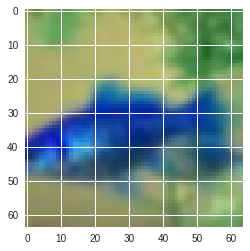

In [0]:
import cv2

img=cv2.imread('n01443537_24.JPEG')
blurer = iaa.GaussianBlur(1.0)
img_gb = blurer.augment_image(img)
plt.imshow(img_gb)

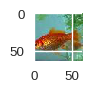

(64, 64, 3)


AssertionError: ignored

In [0]:
import imgaug as ia
from imgaug import augmenters as iaa
import numpy as np
from skimage import data

# Number of batches and batch size for this example
nb_batches = 10
batch_size = 32
images = np.zeros((5, 64, 64, 3))

# # Example augmentation sequence to run in the background
# augseq = iaa.Sequential([
# #     iaa.Fliplr(0.5),
# #     iaa.CoarseDropout(p=0.1, size_percent=0.1)
#   iaa.Fliplr(0.5, name="Flipper"),
#   iaa.GaussianBlur((0, 3.0), name="GaussianBlur"),
#   iaa.Dropout(0.02, name="Dropout"),
#   iaa.AdditiveGaussianNoise(scale=0.01*255, name="MyLittleNoise"),
#   iaa.AdditiveGaussianNoise(loc=32, scale=0.0001*255, name="SomeOtherNoise"),
#   iaa.Affine(translate_px={"x": (-40, 40)}, name="Affine")
# ])

# For simplicity, we use the same image here many times
astronaut = imageio.imread('n01443537_24.JPEG')
astronaut = ia.imresize_single_image(astronaut, (64, 64))

ia.imshow(astronaut)
print(astronaut.shape)

flipper = iaa.Fliplr(1.0) # always horizontally flip each input image
images[0] = flipper.augment_image(astronaut) # horizontally flip image 0

# vflipper = iaa.Flipud(0.9) # vertically flip each input image with 90% probability
# images[1] = vflipper.augment_image(astronaut) # probably vertically flip image 1

# blurer = iaa.GaussianBlur(3.0)
# images[2] = blurer.augment_image(astronaut) # blur image 2 by a sigma of 3.0
# images[3] = blurer.augment_image(astronaut) # blur image 3 by a sigma of 3.0 too

# translater = iaa.Affine(translate_px={"x": -16}) # move each input image by 16px to the left
# images[4] = translater.augment_image(astronaut) # move image 4 to the left

# scaler = iaa.Affine(scale={"y": (0.8, 1.2)}) # scale each input image to 80-120% on the y axis
# images[5] = scaler.augment_image(astronaut) # scale image 5 by 80-120% on the y axis



# Make batches out of the example image (here: 10 batches, each 32 times
# the example image)
batches = []
for _ in range(nb_batches):
    batches.append(
        np.array(
            [images for _ in range(batch_size)],
            dtype=np.uint8
        )
    )

# Show the augmented images.
# Note that augment_batches() returns a generator.
for images_aug in augseq.augment_batches(batches, background=True):
    ia.imshow(ia.draw_grid(images_aug, cols=8))

In [0]:
images_aug.shape

(32, 64, 64, 3)

In [0]:
from imgaug import augmenters as iaa

nb_batches = 10
batch_size = 32

seq = iaa.Sequential([
    iaa.Fliplr(0.5), # horizontally flip
    iaa.CoarseDropout(p=0.1, size_percent=0.1)
])
seq_det = seq.to_deterministic()

In [0]:
def do_augmentation(seq_det, X_train, y_train):
    # Move from 0-1 float to uint8 format (needed for most imgaug operators)
    X_train_aug = [(x[:,:,:] * 255.0).astype(np.uint8) for x in X_train]
    # Do augmentation
    X_train_aug = seq_det.augment_images(X_train_aug)
    # Back to 0-1 float range
    X_train_aug = [(x[:,:,:].astype(np.float64)) / 255.0 for x in X_train_aug]

    y_train_aug = [y for y in y_train]
    return np.array(X_train_aug), np.array(y_train_aug)

In [0]:
y_train.shape

(100000, 200)

In [0]:
# Return augmented images/masks arrays of batch size
def generator(features, labels, batch_size, seq_det):
    # create empty arrays to contain batch of features and labels
    batch_features = np.zeros((batch_size, features.shape[1], features.shape[2], features.shape[3]))
    batch_labels = np.zeros((batch_size, labels.shape[1]))

    while True:
        # Fill arrays of batch size with augmented data taken randomly from full passed arrays
        indexes = random.sample(range(len(features)), batch_size)
        # Perform the exactly the same augmentation for X and y
        random_augmented_images, random_augmented_labels = do_augmentation(seq_det, features[indexes], labels[indexes])
        batch_features[:,:,:,:] = random_augmented_images[:,:,:,:]
        batch_labels[:,:,:,:] = random_augmented_labels[:,:,:,:]

        yield batch_features, batch_labels

In [0]:
X_train[0].shape

(64, 64, 3)

In [0]:
from google.colab import files
files.upload()

Saving n01443537_24.JPEG to n01443537_24.JPEG


{'n01443537_24.JPEG': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\x00@\x00@\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\

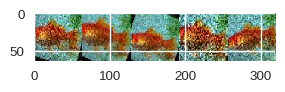

In [0]:
# seq = iaa.Sequential([
#   iaa.Fliplr(0.5),
#   iaa.GaussianBlur(sigma=(0, 0.3)),
#   iaa.Add((-45, 45)), random_order=True])
import imgaug as ia
import imageio
im = imageio.imread('n01443537_24.JPEG')    
#im = np.array(Image.open('n01443537_24.JPEG'))
ia.seed(4)
image = [im, im, im, im, im]

seq = iaa.Sequential([
#     iaa.Fliplr(0.5),
#     iaa.Grayscale(alpha=(0.0, 1.0))
    iaa.Affine(rotate=(-25, 25)),
    iaa.AdditiveGaussianNoise(scale=(10, 60)),
    iaa.Crop(percent=(0, 0.2))
])    
images_aug = seq.augment_images(image)

ia.imshow(np.hstack(images_aug))

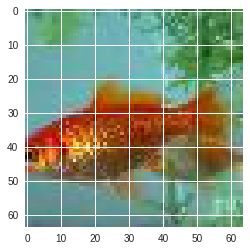

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.imshow(im)

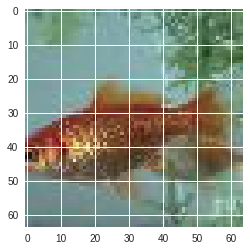

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.imshow(images_aug[0])


In [0]:


genNorm = ImageDataGenerator(rotation_range=10, width_shift_range=0.1, 
       height_shift_range=0.1, zoom_range=0.1, horizontal_flip=True)

astronaut = imageio.imread('n01443537_24.JPEG')
astronaut = ia.imresize_single_image(astronaut, (64, 64))

batches = genNorm.flow_from_directory(pastronaut, target_size=(224,224),
      class_mode='categorical', batch_size=64)

x_batch, y_batch = next(batches)

for i in range (0,32):
    image = x_batch[i]
    plt.imshow(image.transpose(2,1,0))
    plt.show()

NameError: ignored